# Analysis of DeepProfiler experiment SPECS3K

In [5]:
%matplotlib inline

import numpy as np
import pandas as pd
from tqdm import tqdm

from sklearn.neighbors import KNeighborsClassifier
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import sklearn.metrics

import scipy.linalg
import scipy.spatial.distance

import matplotlib.pyplot as plt
import matplotlib
matplotlib.rc('ytick', labelsize=7)
import seaborn as sns
import os
from umap import UMAP

In [6]:
import psutil
import polars as pl

In [ ]:
import sys
!{sys.executable} -m pip install plotly


pip 23.2.1 from /usr/local/lib/python3.8/dist-packages/pip (python 3.8)


In [6]:
pid = os.getpid()
print(f"PID of this notebook: {pid}")
def notebook_memory_usage(pid):
    process = psutil.Process(pid)
    memory_info = process.memory_info()
    return memory_info.rss / (1024 ** 2)  # Convert bytes to MB

# Usage
print(f"Memory Usage of Notebook: {notebook_memory_usage(pid)} MB")

PID of this notebook: 1311182
Memory Usage of Notebook: 567.98046875 MB


## Set paths and load functions

In [3]:
featdir = "outputs/results/features"
PROJECT_ROOT = "/share/data/analyses/benjamin/Single_cell_project/DP_specs3k/"
#EXP = "cp_dataset"
#OUTPUT_FILE = "well_level_data_efn128combinedplatesout_conv6a_1e-2_e30.csv"
#MATRIX_FILE = "cos_efn128combinedplatesout_conv6a_1e-2_e30.csv"
REG_PARAM = 1e-2


In [4]:
def make_plot_custom(embedding, colouring, save_dir=False, file_name="file_name", name="Emb type", description="details"):
    # Set the background to white
    sns.set(style="whitegrid", rc={"figure.figsize": (18, 12),'figure.dpi': 300, "axes.facecolor": "white", "grid.color": "white"})
    
    # Create a custom palette for the treatments of interest
    unique_treatments = set(embedding[colouring])
    custom_palette = sns.color_palette("hls", len(unique_treatments))
    color_dict = {treatment: color for treatment, color in zip(unique_treatments, custom_palette)}
    
    # Make the "Control" group grey
    if "DMSO_0.1%" in color_dict:
        color_dict["DMSO_0.1%"] = "lightgrey"
    
    # Create a size mapping
    size_dict = {treatment: 20 if treatment != "DMSO_0.1%" else 8 for treatment in unique_treatments}
    embedding['size'] = embedding[colouring].map(size_dict)
    
    # Create the scatter plot
    sns_plot = sns.scatterplot(data=embedding, x="UMAP 1", y="UMAP 2", hue=colouring, size='size', palette=color_dict, sizes=(8, 25), linewidth=0.1, alpha=0.9)
    
    plt.suptitle(f"{name}_{file_name}", fontsize=16)
    sns_plot.tick_params(labelbottom=False, labelleft=False, bottom=False, left=False)
    sns_plot.set_title("CLS Token embedding of "+str(len(embedding))+" cells" + " \n"+description, fontsize=12)
    sns.move_legend(sns_plot, "lower left", title='Treatments', prop={'size': 10}, title_fontsize=12, markerscale=0.5)
    
    # Remove grid lines
    sns.despine(bottom=True, left=True)
    
    if save_dir == True:
        # Save the figure with the specified DPI
        sns_plot.figure.savefig(f"{save_dir}{file_name}{name}.png", dpi=600)  # Changed DPI to 600
        sns_plot.figure.savefig(f"{save_dir}pdf_format/{file_name}{name}.pdf", dpi=600)  # Changed DPI to 600
    
    plt.show()

import plotly.express as px
import plotly.graph_objects as go

def make_plot_custom_plotly(embedding, colouring, save_dir=False, file_name="file_name", name="Emb type", description="details"):
    
    # Create a custom palette for the treatments of interest
    unique_treatments = set(embedding[colouring])
    custom_palette = px.colors.qualitative.Set1[:len(unique_treatments)]
    color_dict = {treatment: color for treatment, color in zip(unique_treatments, custom_palette)}
    
    # Make the "Control" group grey
    if "DMSO_0.1%" in color_dict:
        color_dict["DMSO_0.1%"] = "lightgrey"
    
    # Create a size mapping
    size_dict = {treatment: 6 if treatment != "DMSO_0.1%" else 3 for treatment in unique_treatments}
    embedding['size'] = embedding[colouring].map(size_dict)
    
    # Create a Plotly scatter plot
    fig = px.scatter(embedding, x="UMAP 1", y="UMAP 2", color=colouring, size='size', color_discrete_map=color_dict, size_max=6, opacity=0.9, width=1000, height=700)

    # Customize the plot
    fig.update_layout(
        title={
            'text': f"{name}_{file_name} - UMAP embedding of {len(embedding)} cells \n{description}",
            'y':0.95,
            'x':0.5,
            'xanchor': 'center',
            'yanchor': 'top'},
        plot_bgcolor='white',
        showlegend=True,
        xaxis_title="UMAP 1",
        yaxis_title="UMAP 2",
        xaxis_showgrid=False,
        yaxis_showgrid=False
    )
    
    # Remove axis ticks and labels
    fig.update_xaxes(showticklabels=False, zeroline=False)
    fig.update_yaxes(showticklabels=False, zeroline=False)

    # Save the figure if required
    if save_dir:
        fig.write_image(f"{save_dir}{file_name}{name}.png")
        fig.write_image(f"{save_dir}pdf_format/{file_name}{name}.pdf")
    
    # Show the plot
    fig.show()


import plotly.express as px
import plotly.io as pio

def make_plot_custom_plotly_print(embedding, colouring, save_dir=False, file_name="file_name", name="Emb type", description="details"):
    
    # Define your custom color mapping based on conditions
    def get_color(val):
        if "_1" in val:
            return "#28B6D2"
        elif "_5" in val:
            return "#e96565"
        elif val == "DMSO_0.1%":
            return "lightgrey"
        else:
            return "grey"  # A default color for treatments that don't fit any of the conditions
    
    unique_treatments = set(embedding[colouring])
    color_dict = {treatment: get_color(treatment) for treatment in unique_treatments}
    low_conc = embedding[embedding[colouring].str.contains("_1")][colouring].unique()[0]
    high_conc = embedding[embedding[colouring].str.contains("_5")][colouring].unique()[0]
    # Create a size mapping
    size_dict = {treatment: 8 if treatment != "DMSO_0.1%" else 5 for treatment in unique_treatments}
    embedding['size'] = embedding[colouring].map(size_dict)
    
    fig = go.Figure()
    df_dmso = embedding[embedding[colouring] == "DMSO_0.1%"]
    fig.add_trace(
        go.Scatter(
            x=df_dmso["UMAP 1"],
            y=df_dmso["UMAP 2"],
            mode="markers",
            marker=dict(
                color=color_dict["DMSO_0.1%"],
                size=df_dmso['size']
            ),
            name="DMSO_0.1%"
        )
    )

    # Add "_1" dots
    df_1 = embedding[embedding[colouring].str.contains("_1")]
    fig.add_trace(
        go.Scatter(
            x=df_1["UMAP 1"],
            y=df_1["UMAP 2"],
            mode="markers",
            marker=dict(
                color=color_dict[low_conc],
                size=df_1['size']
            ),
            opacity=1,
            name=str(low_conc))
        )
    

    # Add "_5" dots
    df_5 = embedding[embedding[colouring].str.contains("_5")]
    fig.add_trace(
        go.Scatter(
            x=df_5["UMAP 1"],
            y=df_5["UMAP 2"],
            mode="markers",
            marker=dict(
                color=color_dict[high_conc],
                size=df_5['size']
            ),
            opacity=1,
            name=str(high_conc)
        )
    )

    # Customize the plot
    fig.update_layout(
        width = 1200,
        height = 900,
        title={
            'text': f"{name}_{file_name} embedding of {len(embedding)} cells \n{description}",
            'y':0.95,
            'x':0.5,
            'xanchor': 'center',
            'yanchor': 'top'},
        plot_bgcolor='white',
        showlegend=True,
        xaxis_title="UMAP 1",
        yaxis_title="UMAP 2",
        xaxis_showgrid=False,
        yaxis_showgrid=False
    )
    
    # Remove axis ticks and labels
    fig.update_xaxes(showticklabels=False, zeroline=False)
    fig.update_yaxes(showticklabels=False, zeroline=False)

    # Save the figure if required
    if save_dir:
        #pio.write_image(fig, f"{save_dir}{file_name}{name}.png", scale=3)
        pio.write_image(fig, f"{file_name}{name}.pdf", scale=3)
    
    # Show the plot
    else:
        fig.show()

import seaborn as sns
import matplotlib.pyplot as plt


def make_jointplot(embedding, colouring, cmpd, save_path=None):
    
    # Generate a color palette based on unique values in the colouring column
    unique_treatments = embedding[colouring].unique()
    palette = sns.color_palette("husl", len(unique_treatments))
    color_map = dict(zip(unique_treatments, palette))
    
    # Adjust colors and transparency if colouring is 'Metadat_cmpdName'
    if colouring == 'Metadata_cmpdName':
        if 'DMSO' in color_map:
            color_map['DMSO'] = 'black'
    
    embedding['color'] = embedding[colouring].map(color_map)
    point_size = 20
    embedding['size'] = point_size
    
    # Increase the DPI for displaying
    plt.rcParams['figure.dpi'] = 300
    
    # Create the base joint plot
    g = sns.JointGrid(x='UMAP1', y='UMAP2', data=embedding, height=10)

    # Plot KDE plots for each category
    for treatment in unique_treatments:
        subset = embedding[embedding[colouring] == treatment]
        
        sns.kdeplot(x=subset["UMAP1"], ax=g.ax_marg_x, fill=True, color=color_map[treatment], legend=False)
        sns.kdeplot(y=subset["UMAP2"], ax=g.ax_marg_y, fill=True, color=color_map[treatment], legend=False)

    # Plot the scatter plots
    for treatment in unique_treatments:
        subset = embedding[embedding[colouring] == treatment]
        alpha_val = 0.3 if treatment == 'DMSO' and colouring == 'Metadat_cmpdName' else 0.7
        g.ax_joint.scatter(subset["UMAP1"], subset["UMAP2"], c=subset['color'], s=subset['size'], label=treatment, alpha=alpha_val, edgecolor='white', linewidth=0.5)
    
    g.ax_joint.set_title(cmpd)
    g.ax_joint.legend()

    # Display the plot
    plt.show()

    # Optionally, save the plot with high DPI
    if save_path:
        g.savefig(save_path, dpi=300)


def join_plot_dmso(embedding, plate_column, save_path=None):
    
    # Define the colors
    DMSO_color = 'black'
    other_color = 'lightgrey'

    # Generate a color palette based on unique values in the plate column for DMSO
    unique_plates = embedding[embedding['Metadata_cmpdName'] == 'DMSO'][plate_column].unique()
    palette = sns.color_palette("husl", len(unique_plates))
    plate_color_map = dict(zip(unique_plates, palette))
    
    # Map colors based on condition
    embedding['color'] = embedding.apply(lambda x: plate_color_map[x[plate_column]] if x['Metadata_cmpdName'] == 'DMSO' else other_color, axis=1)
    
    # Define the size for each point
    point_size = 20
    embedding['size'] = embedding.apply(lambda x: 50 if x['Metadata_cmpdName'] == 'DMSO' else point_size, axis=1)
    
    # Increase the DPI for displaying
    plt.rcParams['figure.dpi'] = 300
    
    # Create the base joint plot
    g = sns.JointGrid(x='UMAP1', y='UMAP2', data=embedding, height=10)
    
    subset_other = embedding[embedding['Metadata_cmpdName'] != 'DMSO']
    g.ax_joint.scatter(subset_other["UMAP1"], subset_other["UMAP2"], c=other_color, s=subset_other['size'], label="Others", alpha=0.5, edgecolor='white', linewidth=0.5)
    # Plot KDE plots for DMSO by plate
    for plate in unique_plates:
        subset = embedding[(embedding[plate_column] == plate) & (embedding['Metadata_cmpdName'] == 'DMSO')]
        sns.kdeplot(x=subset["UMAP1"], ax=g.ax_marg_x, fill=True, color=plate_color_map[plate], legend=False)
        sns.kdeplot(y=subset["UMAP2"], ax=g.ax_marg_y, fill=True, color=plate_color_map[plate], legend=False)

    # Plot the scatter plots
    for plate in unique_plates:
        subset = embedding[(embedding[plate_column] == plate) & (embedding['Metadata_cmpdName'] == 'DMSO')]
        g.ax_joint.scatter(subset["UMAP1"], subset["UMAP2"], c=subset['color'], s=subset['size'], label=plate, alpha=0.7, edgecolor='white', linewidth=0.5)
    
    # Plot grey points for other treatments
   

    g.ax_joint.set_title('DMSO by Plate')
    g.ax_joint.legend()

    # Display the plot
    plt.show()

    # Optionally, save the plot with high DPI
    if save_path:
        g.savefig(save_path, dpi=300)

def run_umap(df, feat):
    reducer = UMAP(n_neighbors=n_neighbors_value, metric = "euclidean", min_dist=min_dist_value)
    embedding = reducer.fit_transform(df[feat])
    umap_df = pd.DataFrame(data=embedding, columns=["UMAP1", "UMAP2"])
    umap_df[['Plate', 'Well', 'Site']] = df[['Plate', 'Well', 'Site']].reset_index(drop = True)
    umap_df = pd.merge(umap_df, meta, on=["Plate", "Well", "Site"])
    return umap_df



## Load metadata and features

In [5]:
meta = pd.read_csv(os.path.join(PROJECT_ROOT, "inputs", "metadata", "Metadata_specs3k_DeepProfiler.csv"))
meta = meta.sort_values(by=['Metadata_Well', 'Metadata_Site'])
meta['Metadata_cmpdName'] = meta['Metadata_cmpdName'].str.upper()
meta["Metadata_cmpdNameConc"] = meta["Metadata_cmpdName"] +   " " + meta["Metadata_cmpdConc"].astype(str)

<ipython-input-5-9ec9aa89910f>:1: DtypeWarning: Columns (7) have mixed types. Specify dtype option on import or set low_memory=False.
  meta = pd.read_csv(os.path.join(PROJECT_ROOT, "inputs", "metadata", "Metadata_specs3k_DeepProfiler.csv"))


In [6]:
meta

,Unnamed: 0.1,Unnamed: 0,Metadata_Plate,Metadata_Well,Metadata_Site,Metadata_cmpdName,compound_name,moa,Metadata_cmpdConc,ER,DNA,AGP,RNA,Mito,Metadata_cmpdNameConc
0,0,0,P101334,B02,s1,[DMSO],Dimethyl Sulfoxide,NaN,0.10,P101334/B02_s1_x0_y0_Fluorescence_730_nm_Ex.tiff,P101334/B02_s1_x0_y0_Fluorescence_405_nm_Ex.tiff,P101334/B02_s1_x0_y0_Fluorescence_561_nm_Ex.tiff,P101334/B02_s1_x0_y0_Fluorescence_488_nm_Ex.tiff,P101334/B02_s1_x0_y0_Fluorescence_638_nm_Ex.tiff,[DMSO] 0.1
2532,2532,2532,P101335,B02,s1,CBK308603,NaN,cyclooxygenase inhibitor|lipoxygenase inhibitor,10.00,P101335/B02_s1_x0_y0_Fluorescence_730_nm_Ex.tiff,P101335/B02_s1_x0_y0_Fluorescence_405_nm_Ex.tiff,P101335/B02_s1_x0_y0_Fluorescence_561_nm_Ex.tiff,P101335/B02_s1_x0_y0_Fluorescence_488_nm_Ex.tiff,P101335/B02_s1_x0_y0_Fluorescence_638_nm_Ex.tiff,CBK308603 10.0
5068,5068,5068,P101336,B02,s1,CBK041133,NaN,NaN,10.00,P101336/B02_s1_x0_y0_Fluorescence_730_nm_Ex.tiff,P101336/B02_s1_x0_y0_Fluorescence_405_nm_Ex.tiff,P101336/B02_s1_x0_y0_Fluorescence_561_nm_Ex.tiff,P101336/B02_s1_x0_y0_Fluorescence_488_nm_Ex.tiff,P101336/B02_s1_x0_y0_Fluorescence_638_nm_Ex.tiff,CBK041133 10.0
7654,7654,7654,P101337,B02,s1,CBK308315,NaN,NaN,10.00,P101337/B02_s1_x0_y0_Fluorescence_730_nm_Ex.tiff,P101337/B02_s1_x0_y0_Fluorescence_405_nm_Ex.tiff,P101337/B02_s1_x0_y0_Fluorescence_561_nm_Ex.tiff,P101337/B02_s1_x0_y0_Fluorescence_488_nm_Ex.tiff,P101337/B02_s1_x0_y0_Fluorescence_638_nm_Ex.tiff,CBK308315 10.0
10033,10033,10033,P101338,B02,s1,[FENB],Fenbendazole,NaN,6.25,P101338/B02_s1_x0_y0_Fluorescence_730_nm_Ex.tiff,P101338/B02_s1_x0_y0_Fluorescence_405_nm_Ex.tiff,P101338/B02_s1_x0_y0_Fluorescence_561_nm_Ex.tiff,P101338/B02_s1_x0_y0_Fluorescence_488_nm_Ex.tiff,P101338/B02_s1_x0_y0_Fluorescence_638_nm_Ex.tiff,[FENB] 6.25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
118985,118985,118985,P101381,O23,s9,CBK291071,NaN,tachykinin antagonist,10.00,P101381/O23_s9_x2_y2_Fluorescence_730_nm_Ex.tiff,P101381/O23_s9_x2_y2_Fluorescence_405_nm_Ex.tiff,P101381/O23_s9_x2_y2_Fluorescence_561_nm_Ex.tiff,P101381/O23_s9_x2_y2_Fluorescence_488_nm_Ex.tiff,P101381/O23_s9_x2_y2_Fluorescence_638_nm_Ex.tiff,CBK291071 10.0
123818,123818,123818,P101384,O23,s9,[DMSO],Dimethyl Sulfoxide,NaN,0.10,P101384/O23_s9_x2_y2_Fluorescence_730_nm_Ex.tiff,P101384/O23_s9_x2_y2_Fluorescence_405_nm_Ex.tiff,P101384/O23_s9_x2_y2_Fluorescence_561_nm_Ex.tiff,P101384/O23_s9_x2_y2_Fluorescence_488_nm_Ex.tiff,P101384/O23_s9_x2_y2_Fluorescence_638_nm_Ex.tiff,[DMSO] 0.1
126359,126359,126359,P101385,O23,s9,[DMSO],Dimethyl Sulfoxide,NaN,0.10,P101385/O23_s9_x2_y2_Fluorescence_730_nm_Ex.tiff,P101385/O23_s9_x2_y2_Fluorescence_405_nm_Ex.tiff,P101385/O23_s9_x2_y2_Fluorescence_561_nm_Ex.tiff,P101385/O23_s9_x2_y2_Fluorescence_488_nm_Ex.tiff,P101385/O23_s9_x2_y2_Fluorescence_638_nm_Ex.tiff,[DMSO] 0.1
128991,128991,128991,P101386,O23,s9,[DMSO],Dimethyl Sulfoxide,NaN,0.10,P101386/O23_s9_x2_y2_Fluorescence_730_nm_Ex.tiff,P101386/O23_s9_x2_y2_Fluorescence_405_nm_Ex.tiff,P101386/O23_s9_x2_y2_Fluorescence_561_nm_Ex.tiff,P101386/O23_s9_x2_y2_Fluorescence_488_nm_Ex.tiff,P101386/O23_s9_x2_y2_Fluorescence_638_nm_Ex.tiff,[DMSO] 0.1


In [16]:
classes = meta["Metadata_cmpdName"].dropna().unique()
classes.sort()
classes = { classes[i]:i for i in range(len(classes))}
#validation = meta[meta["replicate_use"] != "Training"]
validation = meta[meta["Metadata_Plate"].isin(["P101334", "P101335", "P101336", "P101337", "P101337", "P101340", "P10145"])]

In [17]:
#inspect what is in the output feature npz file

i = validation.index[0]
#plate = ["P101334", "P101335", "P101336", "P101337", "P101338"]
plate = validation.loc[i, "Metadata_Plate"]
well = validation.loc[i, "Metadata_Well"]
site = validation.loc[i, "Metadata_Site"]


filename = f"{PROJECT_ROOT}/{featdir}/{plate}/{well}/{site}.npz"
print(filename)

with open(filename, "rb") as data:
    info = np.load(data)
    print(list(info.keys()))

/share/data/analyses/benjamin/Single_cell_project/DP_specs3k//outputs/results/features/P101334/B02/s1.npz
['features', 'metadata', 'locations']


In [21]:
predictions = []
real_labels = []
wells = []
i = 0
for i in tqdm(validation.index):
    plate = validation.loc[i, "Metadata_Plate"]
    well  = validation.loc[i, "Metadata_Well"]
    site  = validation.loc[i, "Metadata_Site"]
    
    filename = f"{PROJECT_ROOT}/{featdir}/{plate}/{well}/{site}.npz"
    
    try:
        with open(filename, "rb") as data:
            info = np.load(data)
            predictions.append(info["features"])
            label = validation.loc[i, "Metadata_cmpdNameConc"]
            real_labels.append([classes[label]] * info["features"].shape[0])
            wells.append(f"{plate}_{well}")
    except FileNotFoundError:
        i += 1
        #print(f"File {filename} not found. Skipping...")
        continue

print(f"{i} out of {len(validation)} sites no cells found")

  0%|          | 0/12461 [00:00<?, ?it/s]


KeyError: '[DMSO] 0.1'

In [10]:
import pandas as pd

rows = []
for i in tqdm(validation.index):
    plate = validation.loc[i, "Metadata_Plate"]
    well  = validation.loc[i, "Metadata_Well"]
    site  = validation.loc[i, "Metadata_Site"]
    
    filename = f"{PROJECT_ROOT}/{featdir}/{plate}/{well}/{site}.npz"
    
    try:
        with open(filename, "rb") as data:
            info = np.load(data)
            features_array = info["features"]
            
            for features in features_array:
                row = {
                    "Plate": plate,
                    "Well": well,
                    "Site": site,
                    "Label": label
                }
                for idx, feature in enumerate(features):
                    row[f"Feature_{idx}"] = feature
                
                rows.append(row)
    except FileNotFoundError:
        #print(f"File {filename} not found. Skipping...")
        continue

df = pd.DataFrame(rows)


  0%|          | 17/12461 [00:02<25:37,  8.09it/s]


KeyboardInterrupt: 

In [11]:
import polars as pl
import numpy as np
from tqdm import tqdm

# Define the batch size
batch_size = 500  # Adjust this based on your memory constraints

def process_batch(batch):
    rows = []
    for item in batch:
        plate, well, site, filename = item
        try:
            with open(filename, "rb") as data:
                info = np.load(data)
                features_array = info["features"]
                
                for features in features_array:
                    row = {"Plate": plate, "Well": well, "Site": site, "Label": label}
                    for idx, feature in enumerate(features):
                        row[f"Feature_{idx}"] = feature
                    rows.append(row)
        except FileNotFoundError:
            continue
    return pl.DataFrame(rows)

# Initialize an empty Polars DataFrame for the master file
master_df = pl.DataFrame()

# Process in batches and append to the master DataFrame
for i in tqdm(range(0, len(validation), batch_size)):
    batch = [(validation.loc[j, "Metadata_Plate"],
              validation.loc[j, "Metadata_Well"],
              validation.loc[j, "Metadata_Site"],
              f"{PROJECT_ROOT}/{featdir}/{validation.loc[j, 'Metadata_Plate']}/{validation.loc[j, 'Metadata_Well']}/{validation.loc[j, 'Metadata_Site']}.npz")
             for j in range(i, min(i + batch_size, len(validation)))]

    batch_df = process_batch(batch)
    master_df = pl.concat([master_df, batch_df])

  0%|          | 0/25 [00:00<?, ?it/s]

 56%|█████▌    | 14/25 [29:17<24:48, 135.35s/it]

In [3]:
import tqdm
def find_plate_names(folder_path):
    # Direct path to the 'outputs/features' subfolder
    features_folder = os.path.join(folder_path, "outputs", "results", "features")

    # Check if the 'features' folder exists
    if not os.path.exists(features_folder):
        return "The 'outputs/features' folder does not exist in the given path."

    # List to hold the names of subfolders
    subfolder_names = []

    # Iterate over the items in the 'features' folder
    for item in os.listdir(features_folder):
        item_path = os.path.join(features_folder, item)
        # Check if the item is a folder
        if os.path.isdir(item_path):
            subfolder_names.append(item)

    return subfolder_names


def prep_metadata(projectfolder):
    metadata_folder = os.path.join(projectfolder, "inputs", "metadata")
    if not os.path.exists(metadata_folder):
        return None, "The 'inputs/metadata' folder does not exist in the given path."

    # Find the CSV file in the 'metadata' folder
    for file in os.listdir(metadata_folder):
        if file.endswith(".csv"):
            csv_file_path = os.path.join(metadata_folder, file)
            # Read the CSV file into a pandas DataFrame
            metadata = pd.read_csv(csv_file_path)
    meta = metadata.sort_values(by=['Metadata_Well', 'Metadata_Site'])
    meta['Metadata_cmpdName'] = meta['Metadata_cmpdName'].str.upper()
    meta["Metadata_cmpdNameConc"] = meta["Metadata_cmpdName"] +   " " + meta["Metadata_cmpdConc"].astype(str)    
    #meta.rename(columns={"Metadata_Plate": "Plate", "Metadata_Well": "Well", "Metadata_Site": "Site"}, inplace=True)
    return meta    


def create_parquet(projectfolder: str, metadata):
    #plate_names = find_plate_names(projectfolder)
    plate_names = ['P101335']
    
    for plate in plate_names:
        print("Merging plate ", plate)
        validation = metadata[metadata["Metadata_Plate"] == plate].reset_index()
        if len(validation) < 500:
            batch_size = len(validation)
        else:
            batch_size = 500
        master_df = pl.DataFrame()
# Process in batches and append to the master DataFrame
        for i in range(0, len(validation), batch_size):
            batch = [(validation.loc[j, "Metadata_Plate"],
                    validation.loc[j, "Metadata_Well"],
                    validation.loc[j, "Metadata_Site"],
                    f"{projectfolder}/outputs/results/features/{validation.loc[j, 'Metadata_Plate']}/{validation.loc[j, 'Metadata_Well']}/{validation.loc[j, 'Metadata_Site']}.npz")
                    for j in range(i, min(i + batch_size, len(validation)))]
            batch_df = process_batch(batch)
            master_df = pl.concat([master_df, batch_df])
        meta_pl = pl.DataFrame(metadata)
        merged_features = master_df.join(
                meta_pl,
                on=['Metadata_Plate', 'Metadata_Well', 'Metadata_Site'],  # columns to join on
                how='inner'  # you can change this to 'left', 'right', 'outer' as per your need
            )
        output_folder = os.path.join(projectfolder, "outputs", "results", "parquets")
        if not os.path.exists(output_folder):
            os.makedirs(output_folder, exist_ok=True)

        # Write the DataFrame to Parquet
        master_df.write_parquet(os.path.join(output_folder, f"{plate}_sc_features_parquet.parquet"))


def process_batch(batch):
    print("STARTING BATCH BPROCESSING")
    rows = []
    for item in batch:
        plate, well, site, filename = item
        try:
            with open(filename, "rb") as data:
                info = np.load(data)
                features_array = info["features"]
                for features in features_array:
                    row = {"Metadata_Plate": plate, "Metadata_Well": well, "Metadata_Site": site}
                    for idx, feature in enumerate(features):
                        row[f"Feature_{idx}"] = feature
                    rows.append(row)
        except FileNotFoundError:
            continue
    return pl.DataFrame(rows)

In [4]:
create_parquet(projectfolder = "/home/jovyan/share/data/analyses/benjamin/Single_cell_project/DP_specs3k", metadata = prep_metadata("/home/jovyan/share/data/analyses/benjamin/Single_cell_project/DP_specs3k"))

/tmp/ipykernel_491666/3392561382.py:33: DtypeWarning: Columns (7) have mixed types. Specify dtype option on import or set low_memory=False.
  metadata = pd.read_csv(csv_file_path)


Merging plate  P101335
STARTING BATCH BPROCESSING
STARTING BATCH BPROCESSING


KeyboardInterrupt: 

In [ ]:
file_path = '/share/data/analyses/benjamin/Single_cell_project/DP_specs3k/analysis/specs3k_small_features.parquet'

# Save as pickle only if file does not exist
if not os.path.exists(file_path):
    master_df.write_parquet(file_path)
    print(f"DataFrame saved as '{file_path}'.")
else:
    print(f"File '{file_path}' already exists.")

In [9]:
master_df = pl.read_parquet('specs3k_small_features.parquet')

In [9]:
# merge metadata
#meta = pd.read_csv("metadata.csv")
#meta = meta[["Metadata_cmpdName","Metadata_cmpdNameConc"]]
meta.rename(columns={"Metadata_Plate": "Plate", "Metadata_Well": "Well", "Metadata_Site": "Site"}, inplace=True)
meta["Metadata_cmpdNameConc"] = meta["Metadata_cmpdName"] + "_" +  meta["Metadata_cmpdConc"].astype(str)

In [10]:
df = pd.merge(df, meta, on=["Plate", "Well", "Site"])
df.head()

,Plate,Well,Site,Label,Feature_0,Feature_1,Feature_2,Feature_3,Feature_4,Feature_5,...,Metadata_cmpdNameConc,Metadata_sample_type,Metadata_cmpdConc,Metadata_CellLine,DNA,Mito,AGP,RNA,ER,Metadata_Split
0,P014561,A01,s1.0,NaN,0.270156,2.751563,3.639902,2.005968,0.686388,0.278200,...,BLANK_0,negcon,0,RH30,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w1...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w2...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w3...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w4...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w5...,0.0
1,P014561,A01,s1.0,NaN,0.333880,2.815352,3.697375,2.185930,0.582844,0.331138,...,BLANK_0,negcon,0,RH30,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w1...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w2...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w3...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w4...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w5...,0.0
2,P014561,A01,s1.0,NaN,0.356080,2.892081,3.960638,1.977708,0.567073,0.789425,...,BLANK_0,negcon,0,RH30,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w1...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w2...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w3...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w4...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w5...,0.0
3,P014561,A01,s1.0,NaN,0.237117,2.882714,3.854625,2.057554,0.520350,0.586887,...,BLANK_0,negcon,0,RH30,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w1...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w2...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w3...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w4...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w5...,0.0
4,P014561,A01,s1.0,NaN,0.405717,3.142379,3.894133,1.325141,0.763665,0.598220,...,BLANK_0,negcon,0,RH30,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w1...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w2...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w3...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w4...,P014561/RMS-e02-v01-P014561-RH30-48h_A01_s1_w5...,0.0


In [11]:
features = [col for col in df.columns if "Feature" in col]

In [12]:
meta_features = [ col for col in df.columns if col not in features]

## Run Normalization and spherize

In [13]:
import scipy.stats
from sklearn.preprocessing import StandardScaler, RobustScaler
import pycytominer as pm

def prep_data(df1, features, meta_features, plate):
    mask = ~df1['Metadata_cmpdName'].isin(['BLANK', 'UNTREATED'])
    filtered_df = df1[mask]
    temp1 = filtered_df.copy()
    temp1 = temp1.loc[(temp1['Plate'] == plate)]
    data_norm = pm.normalize(profiles = temp1, features =  features, meta_features = meta_features, samples = "Metadata_cmpdName == 'DMSO'", method = "mad_robustize")
    print("Feature selection starts, shape:", data_norm.shape)
    df_selected = pm.feature_select(data_norm, features = features, operation = ['correlation_threshold', 'drop_na_columns'], corr_threshold=0.97)
    print('Number of columns removed:', data_norm.shape[1] - df_selected.shape[1])
    #out = df_selected.dropna().reset_index(drop = True)
    #print('Number of NA rows removed:', df_selected.shape[0] - out.shape[0])
    df_selected["Metadata_cmpdNameConc"] = df_selected["Metadata_cmpdName"] + df_selected["Metadata_cmpdConc"].astype(str)
    return(df_selected)

In [14]:
comp = list(df["Metadata_cmpdName"].unique())
#norm_df = prep_data(df, features, meta_features, compound = comp)

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


In [15]:
plate = list(df["Plate"].unique())
mad_norm_df = pd.DataFrame()
for p in plate:
    temp = prep_data(df, features, meta_features, p)
    mad_norm_df = pd.concat([mad_norm_df, temp], axis = 0)

Feature selection starts, shape: (118769, 688)
Number of columns removed: 0
Feature selection starts, shape: (129055, 688)
Number of columns removed: 0
Feature selection starts, shape: (78417, 688)
Number of columns removed: 0


## Spherize batch correct

In [16]:
import pandas as pd
from sklearn.base import TransformerMixin
from zca import ZCA, ZCA_corr


def apply_norm(normalizer: TransformerMixin, dframe: pd.DataFrame, field: str,
               values, aggregated = True):
    '''Apply normalization considering dframe[field=='value'] as training set.
    Returns the dframe normalized
    '''

    feat_cols = features
    if aggregated:
        meta_cols = ['Plate','Well', 'Site', 'Metadata_cmpdName']
    else:
        meta_cols = meta_features
    meta = dframe[meta_cols]
    train = dframe.loc[dframe[field].isin(values), feat_cols]
    if len(train) == 0:
        raise ValueError(f'{values} not found in {field}')
    normalizer.fit(train)

    norm_feats = normalizer.transform(dframe[feat_cols])
    norm_feats = pd.DataFrame(norm_feats,
                              index=dframe.index,
                              columns=feat_cols)
    dframe = pd.concat([meta, norm_feats], axis=1)
    return dframe


def sphere(dframe: pd.DataFrame, regularization: float, mode: str, column_norm: str, values_norm):
    '''
    Apply sphering using 'negcon' as training set
    '''
    if mode == 'corr':
        normalizer = ZCA_corr(regularization=regularization)
    else:
        normalizer = ZCA(regularization=regularization)
    dframe = apply_norm(normalizer, dframe, column_norm, values_norm, aggregated = True)
    return dframe, normalizer

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


In [19]:
aggregated_df_norm = mad_norm_df.groupby(['Plate','Well', 'Site', 'Metadata_cmpdName'])[features].mean().reset_index()


In [20]:
aggregated_df_norm

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


,Plate,Well,Site,Metadata_cmpdName,Feature_0,Feature_1,Feature_2,Feature_3,Feature_4,Feature_5,...,Feature_662,Feature_663,Feature_664,Feature_665,Feature_666,Feature_667,Feature_668,Feature_669,Feature_670,Feature_671
0,P014561,B02,s1.0,INDINAVIR,-0.519913,0.494653,0.294113,0.339117,0.009634,-0.414995,...,-0.134992,-0.372629,-0.434412,0.136752,0.487067,0.328223,-0.110547,-0.062598,-0.296920,-0.702132
1,P014561,B02,s2.0,INDINAVIR,-0.309041,0.442541,-0.071945,-0.017419,-0.067495,-0.608975,...,-0.100651,-0.152565,-0.083029,0.041718,0.657809,0.472725,-0.287911,-0.239835,-0.268534,-0.472675
2,P014561,B02,s3.0,INDINAVIR,0.560454,-0.948207,-0.006527,0.110926,1.115645,-0.300251,...,-0.004799,0.044089,0.181322,-0.000217,0.328630,-0.144128,-0.642632,0.317548,0.067142,-0.146161
3,P014561,B02,s4.0,INDINAVIR,0.034475,0.194298,-0.441442,-0.320661,-0.052745,-0.355105,...,-0.035901,0.384184,0.118418,-0.032613,0.450171,0.568716,-0.032807,-0.341880,-0.079339,-0.438747
4,P014561,B02,s5.0,INDINAVIR,-0.048644,0.012097,-0.164378,-0.159296,0.486540,-0.107411,...,-0.206475,0.249136,0.153762,0.261555,0.445298,0.478033,-0.168429,-0.068359,0.021598,-0.358396
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2041,P014563,O11,s5.0,DASATINIB,-0.461318,0.294917,-0.599932,-0.077653,0.150456,-1.305438,...,0.126214,0.156570,-0.006372,-0.787446,0.984591,-0.096071,-0.006875,-0.476255,-0.447217,-1.042628
2042,P014563,O12,s1.0,ETOPOSIDE,-1.090122,0.628089,-0.083131,0.647418,-0.505461,-1.354920,...,-0.124399,-1.270401,-0.868351,-0.940146,-0.248804,-1.259970,0.550662,0.928860,-1.277588,-1.034883
2043,P014563,O12,s3.0,ETOPOSIDE,-1.201146,0.853794,-0.307881,0.475380,-0.086215,-1.008990,...,0.212318,-1.325118,-0.512733,-0.720061,0.376539,-0.956370,0.781400,-0.027412,-1.066940,-0.964445
2044,P014563,O12,s4.0,ETOPOSIDE,-0.893706,0.739239,-0.433184,0.533472,-0.266186,-0.870240,...,0.177829,-1.490130,-0.122290,-0.839158,0.412953,-1.391677,0.225443,-0.438355,-1.342746,-1.239964


In [36]:
spherized_df, _ = sphere(aggregated_df_norm , regularization = 0.001, mode = "corr", column_norm = "Metadata_cmpdName", values_norm = ["DMSO"])

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


## Harmony batch normalization

In [24]:
import anndata as ad
import scanpy as sc 
from harmonypy import run_harmony
def create_anndata(df, aggregated):
    data_columns = features  # Columns containing the feature data
    if aggregated:
        meta_data_columns = ['Plate','Well', 'Site', 'Metadata_cmpdName']
    else:
        meta_data_columns = meta_features

    X = df[data_columns].values
    obs = df[meta_data_columns]
    adata = ad.AnnData(X=X, obs=obs)
    return adata

def harmony(adata: ad.AnnData, batch_key: str ,
            corrected_embed: str, pca = True):
    '''Harmony correction'''
    n_latent = min(adata.shape) - 1  # required for arpack
    if pca:
        print('Computing PCA...')
        data_for_harmony = sc.tl.pca(adata, n_comps=n_latent)  # Generates X_pca
        print('Computing PCA Done.')
    else:
        data_for_harmony = adata.X
      
    harmony_out = run_harmony(data_for_harmony,
                              adata.obs,
                              batch_key,
                              max_iter_harmony=20,
                              nclust=len(comp))  # Number of compounds
    adata.obsm[corrected_embed] = harmony_out.Z_corr.T
    return adata

In [28]:
def obsm_to_df(adata: ad.AnnData, obsm_key: str,
               columns: str) -> pd.DataFrame:
    '''Convert AnnData object to DataFrame using obs and obsm properties'''
    meta = adata.obs.reset_index(drop=True)
    feats = adata.obsm[obsm_key]
    n_feats = feats.shape[1]
    if not columns:
        columns = [f'{obsm_key}_{i:04d}' for i in range(n_feats)]
    data = pd.DataFrame(feats, columns=columns)
    return pd.concat([meta, data], axis=1)

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


In [ ]:
import pickle

with open('RH30_pca.pkl', 'wb') as file:
    pickle.dump(pca_df, file)

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


## Show distribution of columns in the data

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


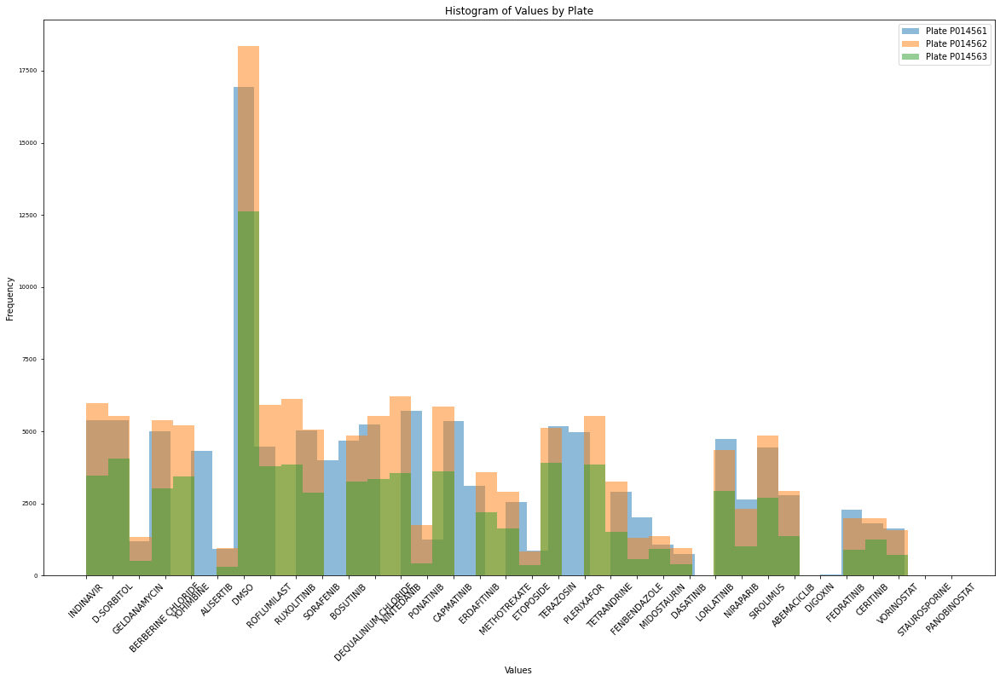

In [18]:
plt.figure(figsize=(20, 12)) 
for group, group_data in mad_norm_df.groupby('Plate'):
    plt.hist(group_data['Metadata_cmpdName'], bins=40, alpha = 0.5, label=f'Plate {group}')

# Add labels and legend
plt.xlabel('Values')
plt.ylabel('Frequency')
plt.title('Histogram of Values by Plate')
plt.legend()
plt.xticks(rotation=45)

# Show the plot
plt.show()

## Site-level UMAP

In [ ]:
from umap import UMAP
import seaborn as sns
import matplotlib.pyplot as plt
feature_columns = [col for col in df.columns if col.startswith("Feature_")]
features = ,[feature_columns]
n_neighbors_value = 400  
min_dist_value = 0.1    

reducer = UMAP(n_neighbors=n_neighbors_value, min_dist=min_dist_value)
embedding = reducer.fit_transform(features[feature_columns])

umap_df = pd.DataFrame(data=embedding, columns=["UMAP1", "UMAP2"])
umap_df["Metadata_cmpdName"] = df["Metadata_cmpdName"]

ImportError: cannot import name 'UMAP' from 'umap' (/home/jovyan/.local/lib/python3.8/site-packages/umap/__init__.py)

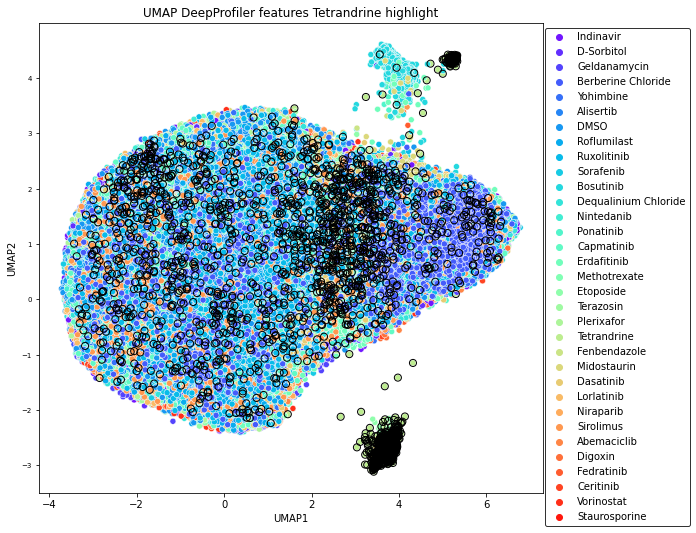

In [ ]:
umap_df_noblank = umap_df[umap_df['Metadata_cmpdName'] != 'blank']
highlight_treatments = ["Tetrandrine"]
plt.figure(figsize=(10, 8))
sns.scatterplot(x="UMAP1", y="UMAP2", hue="Metadata_cmpdName", data=umap_df_noblank, palette="rainbow")
plt.title("UMAP DeepProfiler features Tetrandrine highlight")
for treatment in highlight_treatments:
    selected_data = umap_df_noblank[umap_df_noblank['Metadata_cmpdName'] == treatment]
    plt.scatter(selected_data['UMAP1'], selected_data['UMAP2'], facecolors='none', edgecolors='black', linewidths=1, s=50)

legend = plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1))

# Adjust the legend box position and size
legend.get_frame().set_edgecolor('black')  # Border color
legend.get_frame().set_linewidth(1)        # Border width
plt.tight_layout() 
plt.show()

In [ ]:
pca = PCA(n_components=2)
principal_components = pca.fit_transform(grouped_features[feature_columns])

pca_df = pd.DataFrame(data=principal_components, columns=["Principal Component 1", "Principal Component 2"])
pca_df[['Plate', 'Well', 'Site']] = grouped_features[['Plate', 'Well', 'Site']]
pca_df = pd.merge(pca_df, meta, on=["Plate","Well", "Site"])

plt.figure(figsize=(10, 8))
sns.scatterplot(x="Principal Component 1", y="Principal Component 2", hue="Metadata_cmpdName", data=pca_df, palette="rainbow")
plt.title("PCA of Mean Features Colored by Well")
plt.show()

In [53]:
import seaborn as sns
import matplotlib.pyplot as plt

n_neighbors_value = 35
min_dist_value = 0.1
#mask = ~df['Metadata_cmpdName'].isin(['blank', 'UNTREATED'])

# Use the mask to filter the DataFrame and keep only the desired rows
#filtered_df = df
#grouped_features = filtered_df.groupby(['Plate','Well', 'Site'])[feature_columns].mean().reset_index()
harmony_features = [col for col in harmony_df.columns if "harm" in col]

def run_umap(df, feat):
    reducer = UMAP(n_neighbors=n_neighbors_value, metric = "cosine", min_dist=min_dist_value)
    embedding = reducer.fit_transform(df[feat])

    umap_df = pd.DataFrame(data=embedding, columns=["UMAP1", "UMAP2"])
    umap_df[['Plate', 'Well', 'Site']] = df[['Plate', 'Well', 'Site']]

    umap_df = pd.merge(umap_df, meta, on=["Plate", "Well", "Site"])
    return umap_df

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



NameError: name 'harmony_df' is not defined

In [136]:
umap_df = run_umap(harmony_df, harmony_features)

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



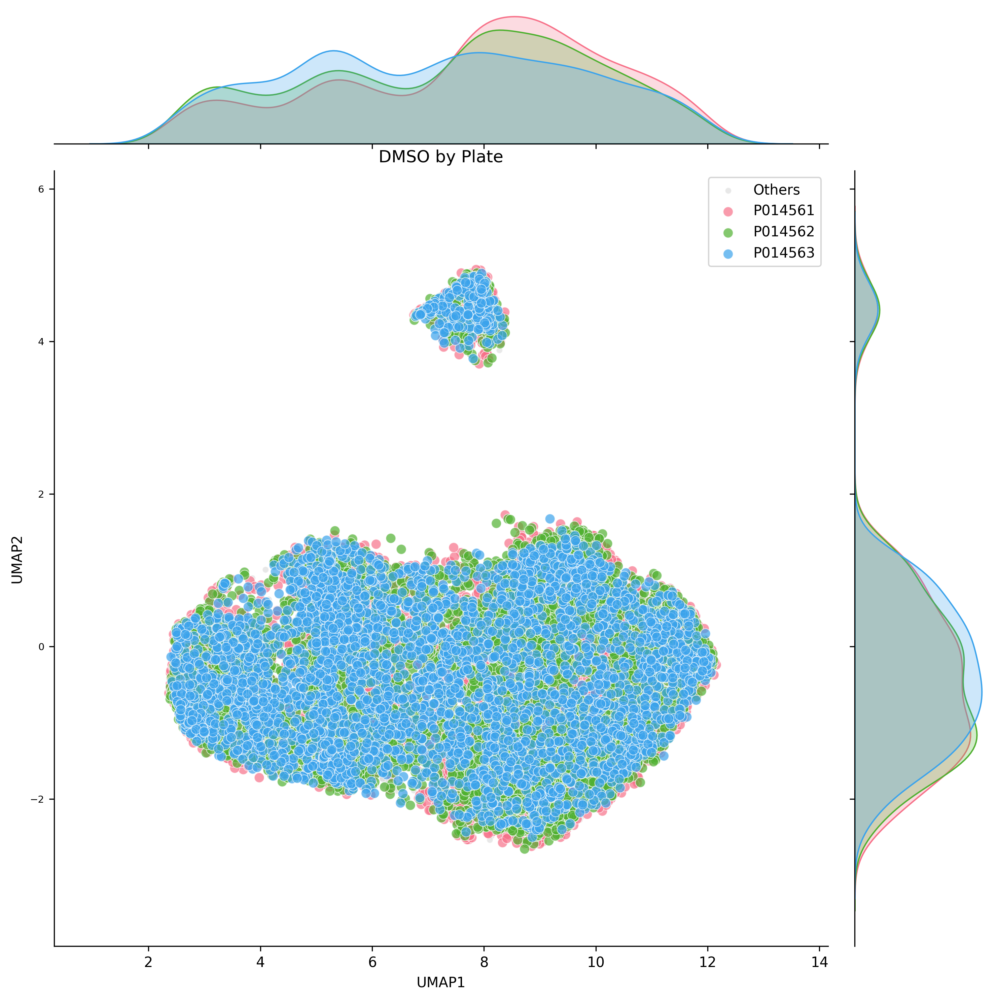

In [102]:
join_plot_dmso(res, "Plate")

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.

<ipython-input-34-214d93eaf958>:218: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.

<ipython-input-34-214d93eaf958>:219: UserWarning:

Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.



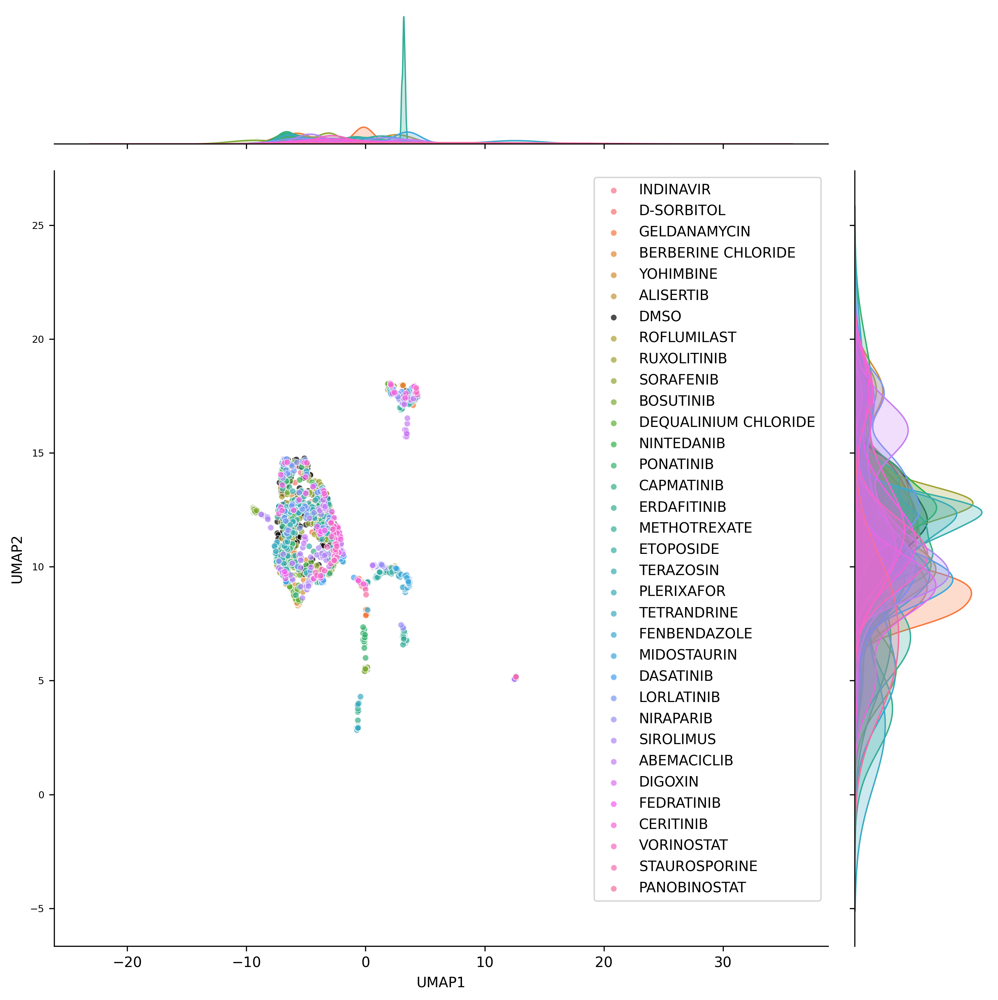

In [138]:
make_jointplot(umap_df, "Metadata_cmpdName", cmpd ="")

In [ ]:
plt.figure(figsize=(20, 12))
sns.scatterplot(x="UMAP1", y="UMAP2", hue="Plate", data=umap_df, palette="rainbow")
plt.title("UMAP DeepProfiler features")
legend = plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1))

# Adjust the legend box position and size
legend.get_frame().set_edgecolor('black')  # Border color
legend.get_frame().set_linewidth(1)        # Border width
plt.tight_layout()    
plt.show()

NameError: name 'umap_df' is not defined

<Figure size 1440x864 with 0 Axes>

## Run PCA on features

In [ ]:
def run_pca(df, plot = True):
    x = df.drop(columns=meta_features)
    #.clip(lower = -50, upper=50)
    pca = PCA(n_components=2)

    principalComponents = pca.fit_transform(x)
    principalDf = pd.DataFrame(data = principalComponents)
    principalDf.rename(columns={0: 'pc1', 1: 'pc2', 2: 'pc 3'}, inplace=True)
    principal_out = pd.concat([principalDf, df[meta_features].reset_index()], axis = 1)
    #principalDf = pd.concat([principalDf].reset_index(), axis = 1).dropna()
    variance_ratio = pca.explained_variance_ratio_
    if plot:
        fig = plt.figure(figsize = (14,6))
        ax = fig.add_subplot(111) 
        ax.set_xlabel('PC 1: {:.2%}'.format(variance_ratio[0]), fontsize = 10)
        ax.set_ylabel('PC 2: {:.2%}'.format(variance_ratio[1]), fontsize = 10)
        ax.spines['top'].set_color('w')
        ax.spines['right'].set_color('w')
        ax.spines['left'].set_color('grey')
        ax.spines['bottom'].set_color('grey')
            #colors = [ 'grey', 'lime'] #, 'lime',  'darkorange', 'red',  'purple' #,'navy', 'sienna']

        ax =sns.scatterplot(x='pc1', y='pc2', data=principalDf, palette='bright',  s=10, alpha = 0.8,  marker = 'o');
        for i, var in enumerate(pca.components_.T):
            plt.arrow(0, 0, var[0]*max(principalDf["pc1"]), var[1]*max(principalDf["pc2"]), 
                    head_width=0.2, head_length=0.2, linewidth=2, color='red')
            plt.text(var[0]*max(principalDf["pc1"]), var[1]*max(principalDf["pc2"]), x.columns[i], color='red')
        ax.set_facecolor('w')        
        #ax.get_legend().remove()
        ax.grid(False)

        plt.subplots_adjust(top=0.85, wspace=0.1, hspace=0.1, right = 1)
        fig.suptitle('PCA, {}, {}, plate'.format("Single cell data", "RH30"), fontsize = 12)
            #fig.savefig('{}/{}_{}_PCA_DMSOandContrComps.{}'.format(OutputDir,  project, CellLine, figformat),  dpi=150, bbox_inches='tight')
            #fig.savefig('{}/{}_PCA_DMSOandContrComps.{}'.format(OutputDir,  project, 'pdf'),  dpi=150, bbox_inches='tight')
        plt.show()
        return principal_out
    else:
        return principal_out


/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


In [ ]:
def make_plot_custom_plotly_pca(embedding, colouring, save_dir=False, file_name="file_name", name="Emb type", description="details"):
    
    # Create a custom palette for the treatments of interest
    unique_treatments = set(embedding[colouring])
    custom_palette = px.colors.qualitative.Set1[:len(unique_treatments)]
    color_dict = {treatment: color for treatment, color in zip(unique_treatments, custom_palette)}
    
    # Make the "Control" group grey
    if "DMSO 0 RH30" in color_dict:
        color_dict["DMSO 0 RH30"] = "lightgrey"
    
    # Create a size mapping
    size_dict = {treatment: 6 if treatment != "DMSO 0 RH30" else 3 for treatment in unique_treatments}
    embedding['size'] = embedding[colouring].map(size_dict)
    
    # Create a Plotly scatter plot
    fig = px.scatter(embedding, x="pc1", y="pc2", color=colouring, size='size', color_discrete_map=color_dict, size_max=6, opacity=0.9, width=1100, height=700)

    # Customize the plot
    fig.update_layout(
        title={
            'text': f"{name}_{file_name} - CLS Token embedding of {len(embedding)} cells \n{description}",
            'y':0.95,
            'x':0.5,
            'xanchor': 'center',
            'yanchor': 'top'},
        plot_bgcolor='white',
        showlegend=True,
        xaxis_title="pacmap 1",
        yaxis_title="pacmap 2",
        xaxis_showgrid=False,
        yaxis_showgrid=False
    )
    
    # Remove axis ticks and labels
    fig.update_xaxes(showticklabels=False, zeroline=False)
    fig.update_yaxes(showticklabels=False, zeroline=False)

    # Save the figure if required
    if save_dir:
        #pio.write_image(fig, f"{save_dir}{file_name}{name}.png", scale=3)
        pio.write_image(fig, f"{file_name}{name}.pdf", scale=3)
    
    # Show the plot
    #fig.show()

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [ ]:
compounds = ["Alisertib", "Bosutinib", "Fenbendazole", "Methotrexate", "Midostaurin", "Niraparib"]
for c in compounds:
    test_pca = run_pca(mad_norm_df[mad_norm_df["Metadata_cmpdName"].isin(["DMSO", c])], plot = False)
    make_plot_custom_plotly_print(test_pca, "Metadata_cmpdNameConc", save_dir = True, file_name = c, name ="PCA" )

## Single cell UMAP analysis

### Sample data

In [20]:
import pandas as pd
import time
from tqdm import tqdm

def subsample_dataset(df, plate_column, cmpd_column, fraction=0.5):
    '''
    Subsample a dataset while preserving the distribution of plates and Metadata_cmpdName.

    Parameters:
    - df: The original pandas DataFrame.
    - plate_column: The column name representing the plates.
    - cmpd_column: The column name representing the Metadata_cmpdName.
    - fraction: The fraction of data to keep for each group. Default is 0.5 (50%).

    Returns:
    - A subsampled pandas DataFrame.
    '''

    # Start tracking time
    start_time = time.time()

    # List to store subsampled data from each group
    subsampled_data = []

    # Group by plates and Metadata_cmpdName
    grouped = df.groupby([plate_column, cmpd_column])

    # For each group, subsample and append to the subsampled_data list, with progress bar
    for _, group in tqdm(grouped, desc="Subsampling groups", unit="group"):
        subsampled_group = group.sample(frac=fraction, random_state = 42)
        subsampled_data.append(subsampled_group)

    # Concatenate all subsampled groups together
    subsampled_df = pd.concat(subsampled_data, axis=0)

    # Print running time
    end_time = time.time()
    print(f"Finished in {end_time - start_time:.2f} seconds.")

    return subsampled_df


/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


In [40]:
import pandas as pd
import numpy as np
from sklearn.decomposition import PCA
import hdbscan
import time
from tqdm import tqdm

def stratified_subsample_hdbscan(df, plate_col, cmpd_col, features, sample_rate, n_components=50, min_cluster_size=5):
    """
    Stratified subsample for multivariate distributions using HDBSCAN.

    Parameters:
    - df: DataFrame containing the data.
    - plate_col: Column name representing the plates.
    - cmpd_col: Column name representing the metadata_cmpdname.
    - features: List of feature column names.
    - sample_rate: Fraction of data to subsample.
    - n_components: Number of components for PCA.
    - min_cluster_size: Minimum cluster size for HDBSCAN.

    Returns:
    - Subsampled DataFrame.
    """
    
    # Start tracking time
    start_time = time.time()

    # List to store subsampled data from each group
    subsampled_data = []

    # Group by plate and metadata_cmpdname
    groups = df.groupby([plate_col, cmpd_col])

    # Iterate over groups with progress bar using tqdm
    for (plate, cmpd), group in tqdm(groups, desc="Processing groups", unit="group"):
        # Extract feature data for the group
        group_data = group[features]
        if group_data.shape[0]<50 or group_data.shape[1]<50:
            n_components = min(group_data.shape)
        # Apply PCA for dimensionality reduction
        pca = PCA(n_components=n_components)
        reduced_data = pca.fit_transform(group_data)

        # Apply HDBSCAN clustering
        if reduced_data.shape[0] < 2:
            next
        elif reduced_data.shape[0] < 5:
            min_cluster_size = max(reduced_data.shape[0], 2)
        clusterer = hdbscan.HDBSCAN(min_cluster_size=min_cluster_size)
        cluster_labels = clusterer.fit_predict(reduced_data)

        # Stratified sampling from each cluster
        for cluster in np.unique(cluster_labels):
            cluster_indices = np.where(cluster_labels == cluster)[0]
            sample_size = int(sample_rate * len(cluster_indices))
            
            # Randomly sample without replacement
            sampled_indices = np.random.choice(cluster_indices, size=sample_size, replace=False)
            subsampled_data.append(group.iloc[sampled_indices])

    # Concatenate all subsampled groups together
    subsampled_df = pd.concat(subsampled_data, axis=0)

    # Print running time
    end_time = time.time()
    print(f"Finished in {end_time - start_time:.2f} seconds.")

    return subsampled_df

# Usage example:
# Assuming your dataframe is named 'data' and feature columns are named 'feature_1', 'feature_2', ..., 'feature_670'
# features = [f'feature_{i}' for i in range(1, 671)]
# subsampled_data = stratified_subsample_hdbscan(data, 'plate_column_name', 'metadata_cmpdname', features, sample_rate=0.5)

In [21]:
subsample_data = subsample_dataset(mad_norm_df, "Plate", "Metadata_cmpdNameConc", 0.3).reset_index(drop = True)

Subsampling groups: 100%|██████████| 180/180 [00:01<00:00, 158.00group/s]


Finished in 2.20 seconds.


/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


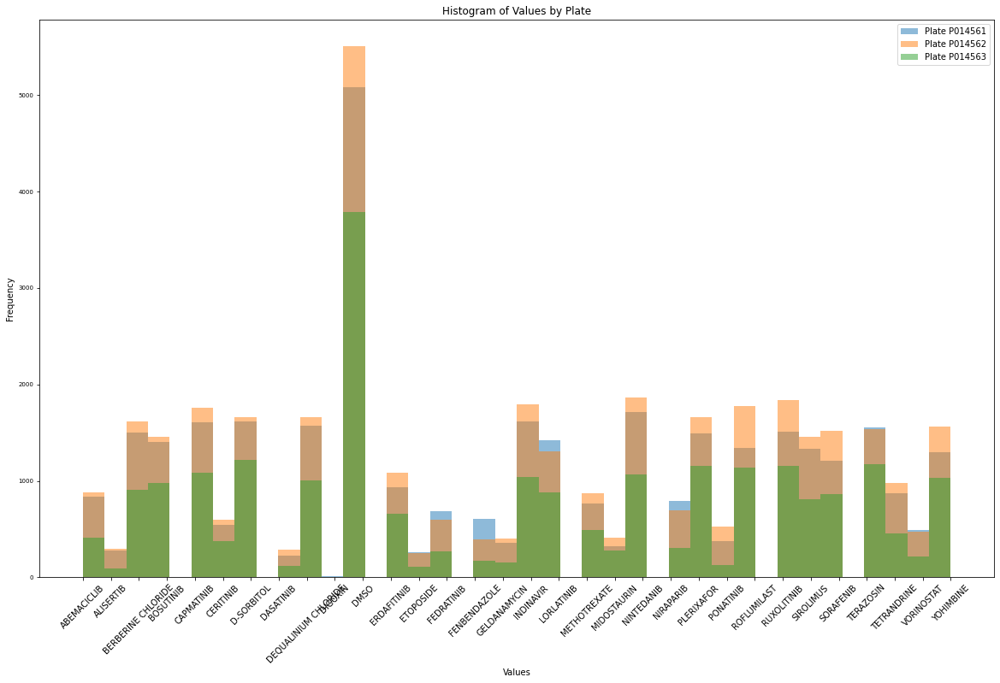

In [22]:
plt.figure(figsize=(20, 12)) 
for group, group_data in subsample_data.groupby('Plate'):
    plt.hist(group_data['Metadata_cmpdName'], bins=40, alpha = 0.5, label=f'Plate {group}')

# Add labels and legend
plt.xlabel('Values')
plt.ylabel('Frequency')
plt.title('Histogram of Values by Plate')
plt.legend()
plt.xticks(rotation=45)

# Show the plot
plt.show()

In [134]:
statified_single_cell = stratified_subsample_hdbscan(mad_norm_df, "Plate", "Metadata_cmpdName", features, sample_rate = 0.3)

Processing groups:  28%|██▊       | 28/99 [03:20<08:12,  6.93s/group]/usr/local/lib/python3.8/dist-packages/sklearn/decomposition/_pca.py:541: RuntimeWarning:

invalid value encountered in true_divide

Processing groups:  28%|██▊       | 28/99 [03:20<08:29,  7.17s/group]


ValueError: Min cluster size must be greater than one

### Normalize single cell dataset

In [48]:
spherized_single_cell, _ = sphere(subsample_data , regularization = 0.001, mode = "corr", column_norm = "Metadata_cmpdName", values_norm = ["DMSO"])

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


In [49]:
from umap import UMAP
import seaborn as sns
import matplotlib.pyplot as plt
#feature_columns = [col for col in df.columns if col.startswith("Feature_")]
#features = df[feature_columns]
n_neighbors_value = 130  
min_dist_value = 0.01    
features_DMSO = subsample_data
#[mad_norm_df['Metadata_cmpdName'].isin(['DMSO', "Bosutinib"])]

reducer = UMAP(n_neighbors=n_neighbors_value, min_dist=min_dist_value, random_state = 42)
embedding = reducer.fit_transform(features_DMSO[features])

#umap_DMSO = pd.DataFrame(data=embedding, columns=["UMAP1", "UMAP2"])
umap_DMSO = features_DMSO.filter([col for col in features_DMSO.columns if col in meta_features])
umap_DMSO["UMAP 1"] = embedding[:, 0]
umap_DMSO["UMAP 2"] = embedding[:, 1]

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
/home/jovyan/.local/lib/python3.8/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.


In [50]:
make_plot_custom_plotly(umap_DMSO, colouring = "Metadata_cmpdNameConc" , file_name = "DeepProfiler", name = "UMAP", description= "")

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


## Compound embeddings

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



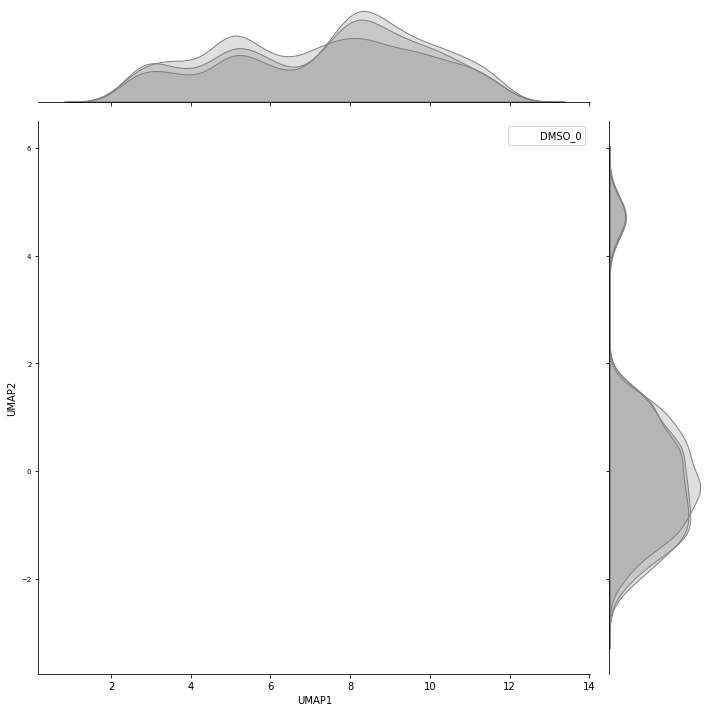

In [101]:
make_jointplot_seaborn(run_umap(harmony_df, harmony_features) , "Plate","")

/home/jovyan/.local/lib/python3.8/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
2023-11-01 11:24:31,778 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-11-01 11:25:55,147 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-11-01 11:25:55,342 - harmonypy - INFO - Iteration 1 of 20
2023-11-01 11:26:22,876 - harmonypy - INFO - Iteration 2 of 20
2023-11-01 11:26:50,866 - harmonypy - INFO - Iteration 3 of 20
2023-11-01 11:27:17,876 - harmonypy - INFO - Iteration 4 of 20
2023-11-01 11:27:45,070 - harmonypy - INFO - Iteration 5 of 20
2023-11-01 11:28:09,773 - harmonypy - INFO - Iteration 6 of 20
2023-11-01 11:28:29,371 - harmonypy - INFO - Iteration 7 of 20
2023-11-01 11:28:48,373 - harmonypy - INFO - Converged after 7 iterations


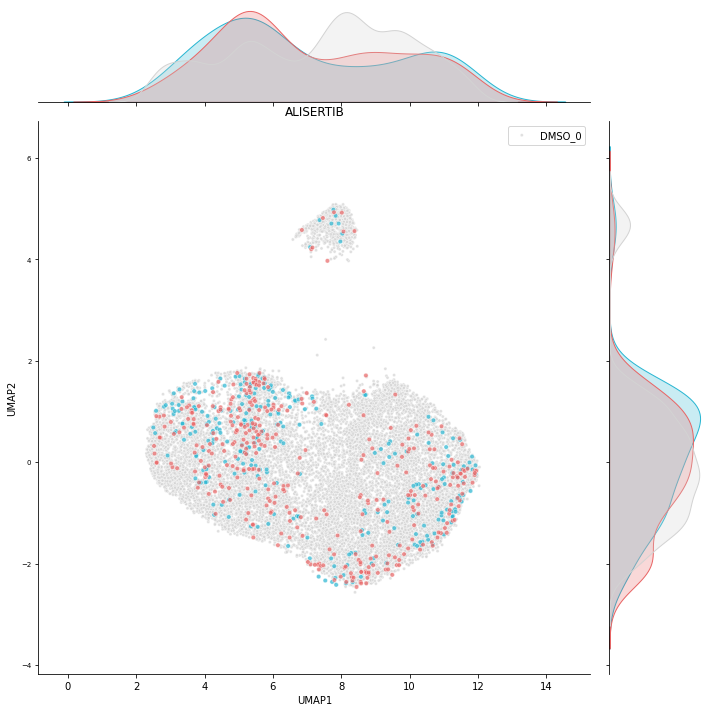

/home/jovyan/.local/lib/python3.8/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
2023-11-01 11:31:02,469 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-11-01 11:32:45,061 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-11-01 11:32:45,258 - harmonypy - INFO - Iteration 1 of 20
2023-11-01 11:33:19,993 - harmonypy - INFO - Iteration 2 of 20
2023-11-01 11:33:54,382 - harmonypy - INFO - Iteration 3 of 20
2023-11-01 11:34:29,093 - harmonypy - INFO - Iteration 4 of 20
2023-11-01 11:34:59,187 - harmonypy - INFO - Iteration 5 of 20
2023-11-01 11:35:29,287 - harmonypy - INFO - Iteration 6 of 20
2023-11-01 11:35:57,002 - harmonypy - INFO - Iteration 7 of 20
2023-11-01 11:36:25,788 - harmonypy - INFO - Iteration 8 of 20
2023-11-01 11:36:52,585 - harmonypy - INFO - Converged after 8 iterations


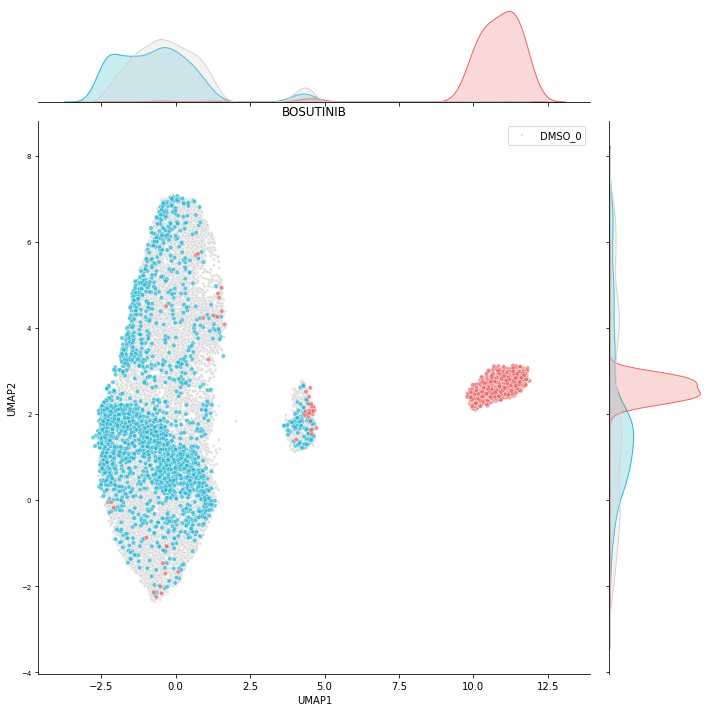

/home/jovyan/.local/lib/python3.8/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
2023-11-01 11:39:04,520 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-11-01 11:40:37,805 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-11-01 11:40:38,040 - harmonypy - INFO - Iteration 1 of 20
2023-11-01 11:41:05,277 - harmonypy - INFO - Iteration 2 of 20
2023-11-01 11:41:32,870 - harmonypy - INFO - Iteration 3 of 20
2023-11-01 11:42:00,570 - harmonypy - INFO - Iteration 4 of 20
2023-11-01 11:42:24,066 - harmonypy - INFO - Iteration 5 of 20
2023-11-01 11:42:51,462 - harmonypy - INFO - Iteration 6 of 20
2023-11-01 11:43:12,577 - harmonypy - INFO - Iteration 7 of 20
2023-11-01 11:43:33,768 - harmonypy - INFO - Converged after 7 iterations


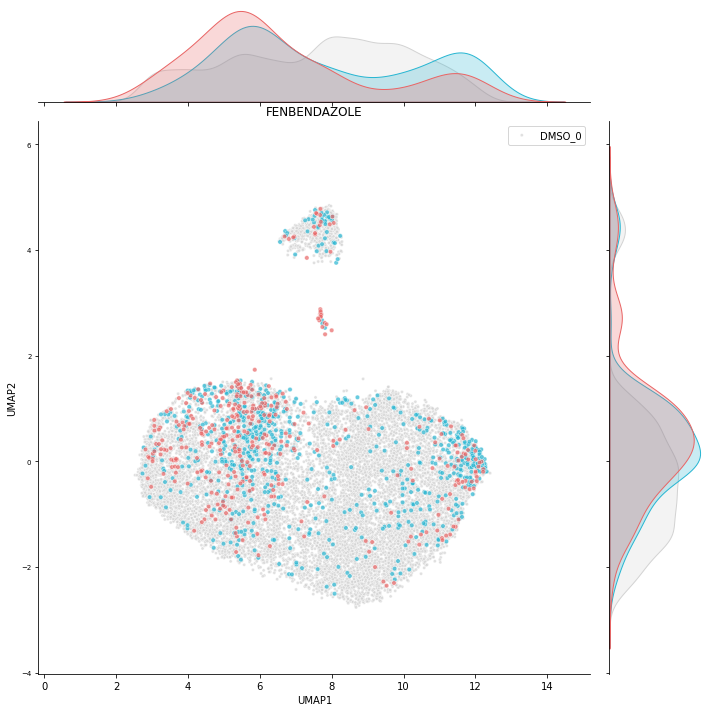

/home/jovyan/.local/lib/python3.8/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
2023-11-01 11:44:53,034 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-11-01 11:46:29,381 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-11-01 11:46:29,655 - harmonypy - INFO - Iteration 1 of 20
2023-11-01 11:47:04,157 - harmonypy - INFO - Iteration 2 of 20
2023-11-01 11:47:38,384 - harmonypy - INFO - Iteration 3 of 20
2023-11-01 11:48:12,384 - harmonypy - INFO - Iteration 4 of 20
2023-11-01 11:48:46,676 - harmonypy - INFO - Iteration 5 of 20
2023-11-01 11:49:17,273 - harmonypy - INFO - Iteration 6 of 20
2023-11-01 11:49:51,677 - harmonypy - INFO - Iteration 7 of 20
2023-11-01 11:50:20,472 - harmonypy - INFO - Iteration 8 of 20
2023-11-01 11:50:48,173 - harmonypy - INFO - Iteration 9 of 20
2023-11-01 11:51:14,071 - harmonypy - INFO - Iteration 10 of 20
2023-11-01 11:51:38,679 - harmonypy - INFO - Iteration

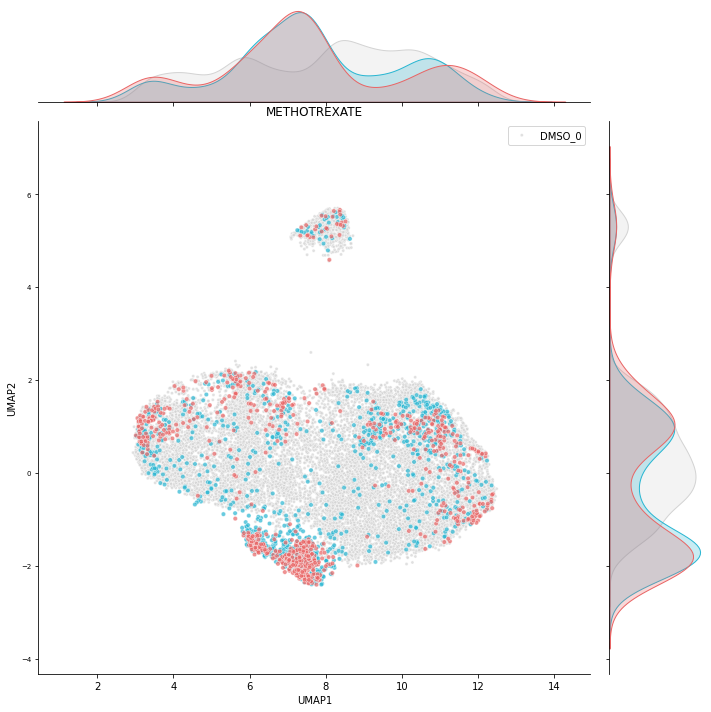

/home/jovyan/.local/lib/python3.8/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
2023-11-01 11:54:41,554 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-11-01 11:56:07,472 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-11-01 11:56:07,648 - harmonypy - INFO - Iteration 1 of 20
2023-11-01 11:56:34,868 - harmonypy - INFO - Iteration 2 of 20
2023-11-01 11:57:01,876 - harmonypy - INFO - Iteration 3 of 20
2023-11-01 11:57:28,570 - harmonypy - INFO - Iteration 4 of 20
2023-11-01 11:57:50,176 - harmonypy - INFO - Iteration 5 of 20
2023-11-01 11:58:12,875 - harmonypy - INFO - Iteration 6 of 20
2023-11-01 11:58:33,575 - harmonypy - INFO - Iteration 7 of 20
2023-11-01 11:58:56,375 - harmonypy - INFO - Converged after 7 iterations


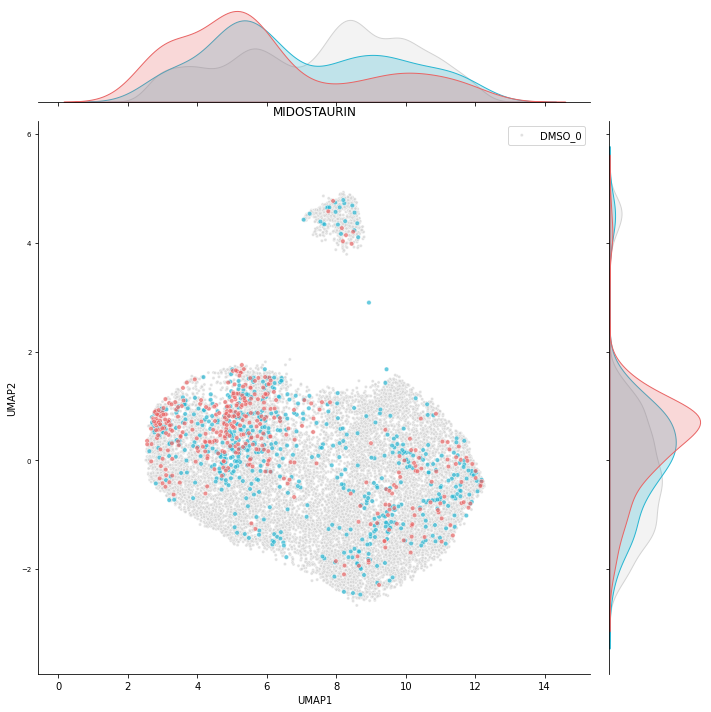

/home/jovyan/.local/lib/python3.8/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
2023-11-01 12:00:34,929 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-11-01 12:02:10,373 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-11-01 12:02:10,553 - harmonypy - INFO - Iteration 1 of 20
2023-11-01 12:02:37,972 - harmonypy - INFO - Iteration 2 of 20
2023-11-01 12:03:05,372 - harmonypy - INFO - Iteration 3 of 20
2023-11-01 12:03:32,685 - harmonypy - INFO - Iteration 4 of 20
2023-11-01 12:03:59,569 - harmonypy - INFO - Iteration 5 of 20
2023-11-01 12:04:25,658 - harmonypy - INFO - Iteration 6 of 20
2023-11-01 12:04:47,181 - harmonypy - INFO - Iteration 7 of 20
2023-11-01 12:05:09,976 - harmonypy - INFO - Converged after 7 iterations


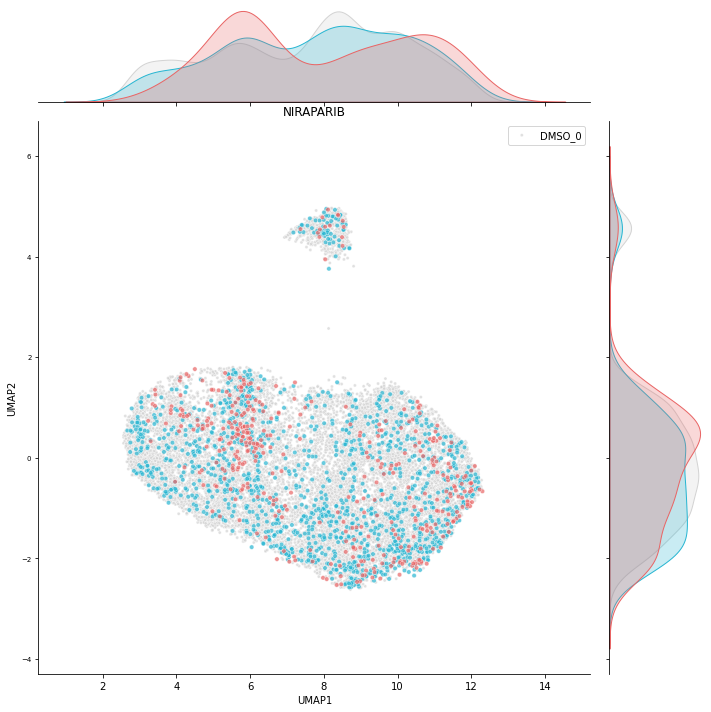

In [29]:
method = "harmony"
compounds = ["ALISERTIB", "BOSUTINIB", "FENBENDAZOLE", "METHOTREXATE", "MIDOSTAURIN", "NIRAPARIB"]
min_dist_value = 0.01
n_neighbors_value = 130

for k in compounds:
    dat = subsample_data[subsample_data['Metadata_cmpdName'].isin(['DMSO', k])]
    if method == "harmony":
        ann_pca = create_anndata(dat, aggregated = True)
        pca_df = harmony(ann_pca, "Plate", "harm", pca = False)
        harmony_df = obsm_to_df(pca_df, obsm_key= "harm", columns = None)
        harmony_features = [col for col in harmony_df.columns if "harm" in col]
        res = run_umap(harmony_df, harmony_features) 
    else:
        res = run_umap(dat, features)

    make_jointplot_seaborn(res, "Metadata_cmpdNameConc",k)
    #make_plot_custom_plotly_print(res, colouring= "Metadata_cmpdNameConc", save_dir = True, file_name = k, name = "UMAP", description= ""),et

## Joinplot

In [25]:
import seaborn as sns
import matplotlib.pyplot as plt


import seaborn as sns
import matplotlib.pyplot as plt

def make_jointplot_seaborn(embedding, colouring, cmpd):
    
    # Define your custom color mapping based on conditions
    def get_color(val):
        if "_1" in val:
            return "#28B6D2"
        elif "_5" in val:
            return "#e96565"
        elif val == "DMSO_0":
            return "lightgrey"
        else:
            return "grey"
    
    # Size mapping
    def get_size(val):
        return 20 if val != "DMSO_0" else 10
    
    embedding['color'] = embedding[colouring].apply(get_color)
    embedding['size'] = embedding[colouring].apply(get_size)
    
    # Create the base joint plot
    g = sns.JointGrid(x='UMAP1', y='UMAP2', data=embedding, height=10)

    # Plot KDE plots for each category
    for treatment in embedding[colouring].unique():
        subset = embedding[embedding[colouring] == treatment]
        
        sns.kdeplot(x=subset["UMAP1"], ax=g.ax_marg_x, fill=True, color=get_color(treatment), legend=False)
        sns.kdeplot(y=subset["UMAP2"], ax=g.ax_marg_y, fill=True, color=get_color(treatment), legend=False)

    # Ensure plotting order: first DMSO_0.1%, then _1, and finally _5
    for treatment in ["DMSO_0", "_1", "_5"]:
        subset = embedding[embedding[colouring].str.contains(treatment)]
        g.ax_joint.scatter(subset["UMAP1"], subset["UMAP2"], c=subset['color'], s=subset['size'], label=f"{treatment} - {len(embedding)} cells", alpha=0.7, edgecolor='white', linewidth=0.5)
    
    g.ax_joint.set_title(cmpd)
    g.ax_joint.legend()

    plt.show()

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



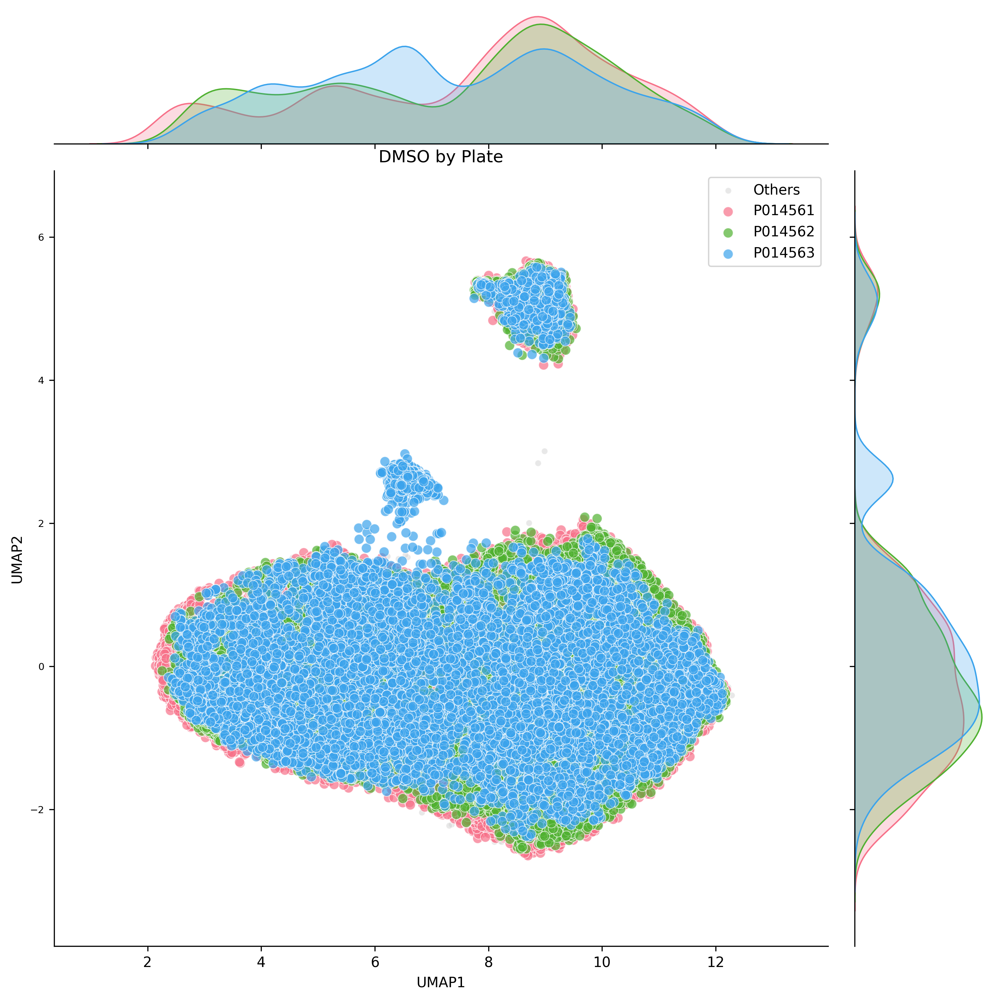

In [117]:
join_plot_dmso(res, "Plate")

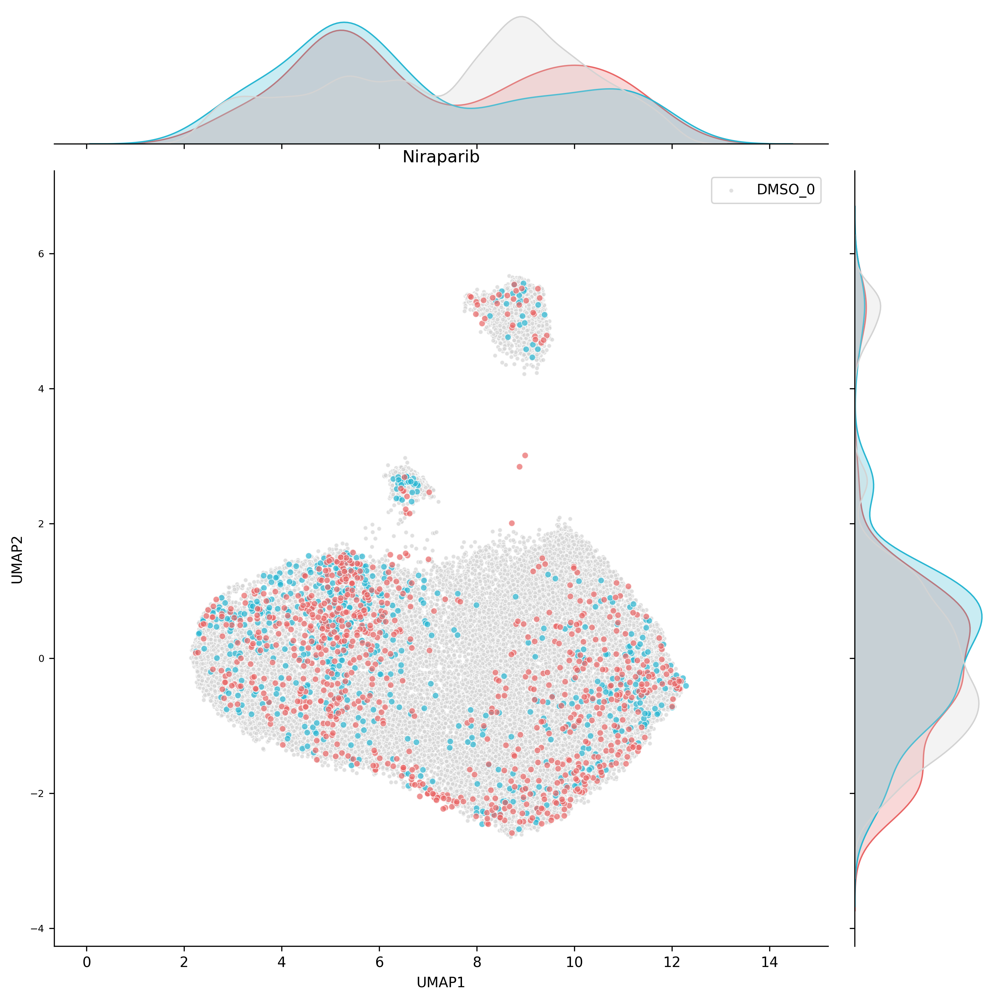

In [116]:
make_jointplot_seaborn(res, "Metadata_cmpdNameConc", "Niraparib")

## PACMAP analysis

In [ ]:
import pacmap

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


In [ ]:
X = norm_df[features]
X.values

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


array([[-1.048713  , -0.03507975, -0.26126963, ...,  1.3689268 ,
        -1.5466086 , -0.10447084],
       [-0.7199629 ,  0.05925973,  0.4285289 , ...,  2.7186828 ,
        -1.3019154 ,  0.29342988],
       [-0.36921933,  0.58322173, -1.0569546 , ..., -0.19892919,
        -0.17564887,  0.06288963],
       ...,
       [ 0.37786308,  0.37904716, -0.15239714, ..., -0.3725151 ,
         0.24538076, -0.97727257],
       [-0.45061097, -0.55219734, -0.22545446, ...,  0.741058  ,
        -0.37141886, -0.30735603],
       [ 0.12353913,  0.714219  ,  0.50728816, ..., -0.88985664,
        -1.1756591 , -1.8410692 ]], dtype=float32)

In [ ]:
embedding = pacmap.PaCMAP(n_components=2, n_neighbors=None, MN_ratio=0.5, FP_ratio=2.0) 

# fit the data (The index of transformed data corresponds to the index of the original data)
X_transformed = embedding.fit_transform(X.values, init="pca")

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


## DMSO PACMAP

In [ ]:
def run_pacmap(norm_df, cmpd = None):
    if cmpd == None:
        norm_df_filt = norm_df[norm_df["Metadata_cmpdName"] == "DMSO"]
        X = norm_df_filt[features]
        embedding = pacmap.PaCMAP(n_components=2, n_neighbors=None, MN_ratio=0.5, FP_ratio=2.0) 
        X_transformed = embedding.fit_transform(X.values, init="pca")
    else:
        norm_df_filt_DMSO = norm_df[norm_df["Metadata_cmpdName"] == "DMSO"]
        X_DMSO = norm_df_filt_DMSO[features]
        embedding = pacmap.PaCMAP(n_components=2, n_neighbors=None, MN_ratio=0.5, FP_ratio=2.0) 
        X_transformed_DMSO = embedding.fit_transform(X_DMSO.values, init="pca")
        X_transformed_DMSO_df = pd.DataFrame(X_transformed_DMSO)
        pacmap_df_DMSO = pd.concat([X_transformed_DMSO_df, norm_df_filt_DMSO[meta_features].reset_index()], axis = 1)

        norm_df_cmpd = norm_df[norm_df["Metadata_cmpdName"] == cmpd]
        X_cmpd = norm_df_cmpd[features]
        X_transformed_cmpd = embedding.transform(X_cmpd.values, basis = X_DMSO.values)
        X_transformed_cmpd_df = pd.DataFrame(X_transformed_cmpd)
        pacmap_df_cmpd = pd.concat([X_transformed_cmpd_df, norm_df_cmpd[meta_features].reset_index()], axis = 1)


        pacmap_df = pd.concat([pacmap_df_DMSO, pacmap_df_cmpd], axis = 0)
    #fig, ax = plt.subplots(1, 1, figsize=(6, 6))
    fig = px.scatter(pacmap_df, x=0, y=1, color="Metadata_cmpdNameConc", 
                    opacity=0.9, width=1000, height=1000)

    fig.update_layout(
    title=f"PACMAP of compound",
    plot_bgcolor='white', 
    xaxis_title="pacmap 1",
    yaxis_title="pacmap 2",
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(showgrid=False, zeroline=False)
    
    )

    fig.update_traces(marker=dict(line=dict(width=0.1, color='Black')))
    # Show the plot
    fig.show()

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [ ]:
norm_df_filt_DMSO = norm_df[norm_df["Metadata_cmpdName"] == "DMSO"]
X_DMSO = norm_df_filt_DMSO[features]
embedding = pacmap.PaCMAP(n_components=2, n_neighbors=None, MN_ratio=0.5, FP_ratio=2.0) 
X_transformed_DMSO = embedding.fit_transform(X_DMSO.values, init="pca")
X_transformed_DMSO_df = pd.DataFrame(X_transformed_DMSO)
pacmap_df_DMSO = pd.concat([X_transformed_DMSO_df, norm_df_filt_DMSO[meta_features].reset_index()], axis = 1)

In [ ]:
compound_list = ["Alisertib", "Bosutinib", "Fenbendazole", "Methotrexate", "Midostaurin", "Niraparib"]

for c in compound_list:
    norm_df_cmpd = norm_df[norm_df["Metadata_cmpdName"] == c]
    X_cmpd = norm_df_cmpd[features]
    X_transformed_cmpd = embedding.transform(X_cmpd.values, basis = X_DMSO.values)
    X_transformed_cmpd_df = pd.DataFrame(X_transformed_cmpd)
    pacmap_df_cmpd = pd.concat([X_transformed_cmpd_df, norm_df_cmpd[meta_features].reset_index()], axis = 1)
    pacmap_df = pd.concat([pacmap_df_DMSO, pacmap_df_cmpd], axis = 0)
    make_plot_custom_plotly(pacmap_df, "Metadata_cmpdNameConc", name = "PACMAP", file_name = c, description = "")

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [ ]:
df_filt_DMSO = df[df["Metadata_cmpdName"] == "DMSO"]
X2_DMSO = df_filt_DMSO[features]
embedding = pacmap.PaCMAP(n_components=2, n_neighbors=None, MN_ratio=0.5, FP_ratio=2.0) 
X2_transformed_DMSO = embedding.fit_transform(X2_DMSO.values, init="pca")
X2_transformed_DMSO_df = pd.DataFrame(X2_transformed_DMSO)
pacmap2_df_DMSO = pd.concat([X2_transformed_DMSO_df, df_filt_DMSO[meta_features].reset_index()], axis = 1)

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [ ]:
make_plot_custom_plotly(pacmap2_df_DMSO, "Metadata_cmpdNameConc")

/usr/local/lib/python3.8/dist-packages/ipykernel/ipkernel.py:281: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [ ]:
make_plot_custom_plotly(pacmap_df, "Metadata_cmpdNameConc", name )

In [ ]:
HAHAHAHAHAHAAH